# Plot all key markers that are key for identification of cell types and populations for subset

In [1]:
import scanpy as sc
import matplotlib.pyplot as plt
import sclitr as sl
import math
import numpy as np
import pandas as pd
import seaborn as sns
from tqdm import tqdm
import math
import anndata as ad

/home/felix/miniconda3/envs/new_sclitr/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_csv from `anndata` is deprecated. Import anndata.io.read_csv instead.
  warnings.warn(msg, FutureWarning)
/home/felix/miniconda3/envs/new_sclitr/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_excel from `anndata` is deprecated. Import anndata.io.read_excel instead.
  warnings.warn(msg, FutureWarning)
/home/felix/miniconda3/envs/new_sclitr/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_hdf from `anndata` is deprecated. Import anndata.io.read_hdf instead.
  warnings.warn(msg, FutureWarning)
/home/felix/miniconda3/envs/new_sclitr/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_loom from `anndata` is deprecated. Import anndata.io.read_loom instead.
  warnings.warn(msg, FutureWarning)
/home/felix/miniconda3/envs/new_sclitr/lib/python3.11/site-packages/anndata/utils.py:429: 

In [2]:
sc.set_figure_params(dpi=300,
                     dpi_save=300,
                     vector_friendly=True,
                     transparent=True,
                    )

In [ ]:
DATA_PATH = "/placodes/data"

In [ ]:
subclustered= sc.read_h5ad(f"{DATA_PATH}/anndatas/reclustered_subset_doublets_removed.h5ad")

In [ ]:
annotations=pd.read_csv(f"{DATA_PATH}/annotations/Annotations_scRNA_clonal - subset.csv")

In [ ]:
annotations = annotations[["re_leiden_2", "annotation"]]

In [7]:
# Give annotation to subclusterd
mapping_dict = annotations.set_index('re_leiden_2')['annotation'].to_dict()
map_dict={}
for x in mapping_dict:
    map_dict[str(x)] = mapping_dict[x]
del mapping_dict
subclustered.obs['reannotation'] = subclustered.obs['re_leiden_2'].map(map_dict)


In [8]:
# Transfer lens
cluster = subclustered[subclustered.obs["re_leiden_2"]=="38"]
tmp_c=cluster[cluster[:,"Cryaa"].X>0].copy()
subclustered.obs.loc[tmp_c.obs_names, "reannotation"] = "Lens"

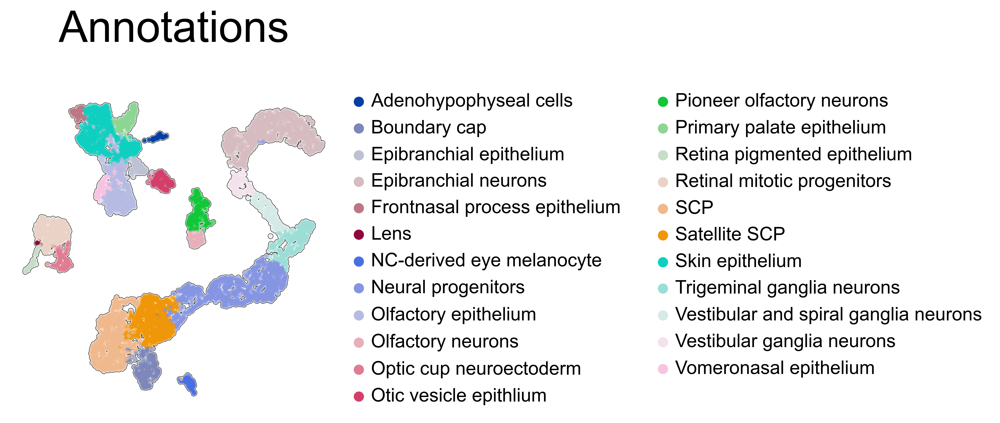

In [ ]:
sc.pl.umap(subclustered,
           color="reannotation",
           size=30,
           frameon=False,  
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           show=False
          ) 

# Add title above the plot while keeping gene name
plt.suptitle("Annotations", fontsize=30, y=1.1, x=0.57)  # Adjust fontsize and y position as needed

# Make the gene name smaller
plt.gca().set_title("", fontsize=14)  # Adjust fontsize as needed

plt.savefig("figures/umap_subset_high_res.svg")

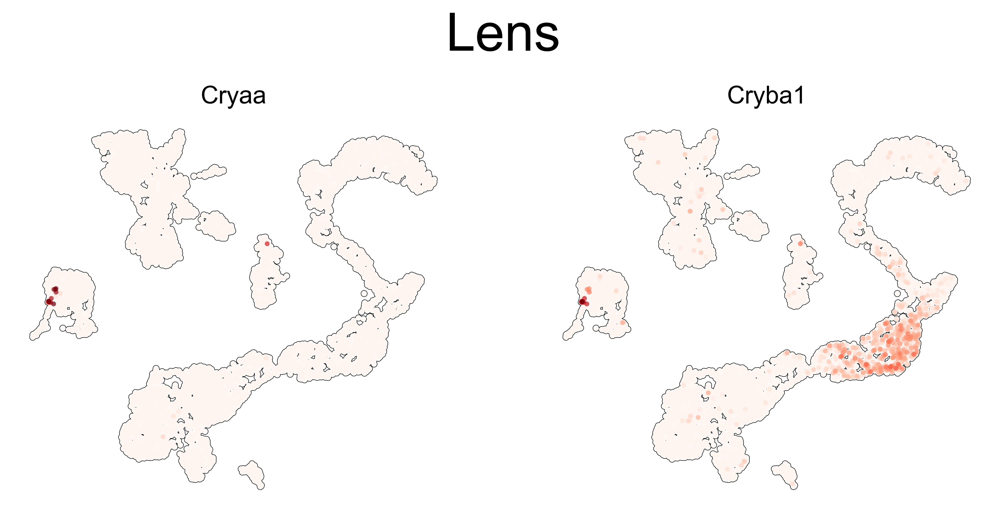

In [ ]:
sc.pl.umap(subclustered,
           color=["Cryaa", "Cryba1"],
           cmap="Reds",
           size=30,
           frameon=False,  
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           show=False
          )

# Add title above the plot while keeping gene name
plt.suptitle("Lens", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make the gene name smaller
#plt.gca().set_title("Cryaa", "Cryba1", fontsize=14)  # Adjust fontsize as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Cryaa", "Cryba1"]
for i, ax in enumerate(axes[:]):  # Only the first 3 axes (the UMAP plots)
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_Lens_high_res.svg")

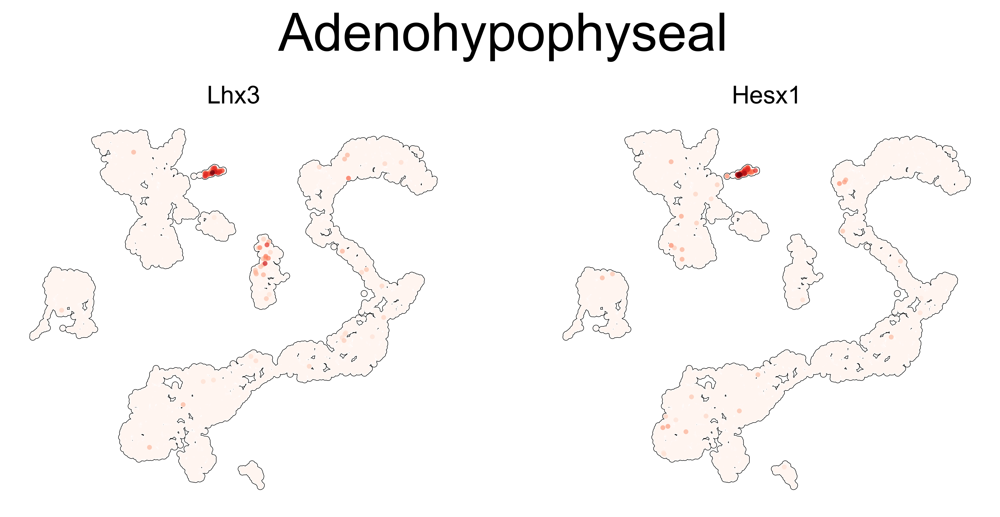

In [12]:
# Adenohypophyseal cells
sc.pl.umap(subclustered,
           color=["Lhx3", "Hesx1"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )


# Add title above the plot while keeping gene name
plt.suptitle("Adenohypophyseal", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make the gene name smaller
#plt.gca().set_title("Lhx3", fontsize=14)  # Adjust fontsize as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Lhx3", "Hesx1"]
for i, ax in enumerate(axes[:]):  # Only the first 3 axes (the UMAP plots)
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed

plt.savefig("figures/umap_subset_Adenohypophyseal_high_res.svg")

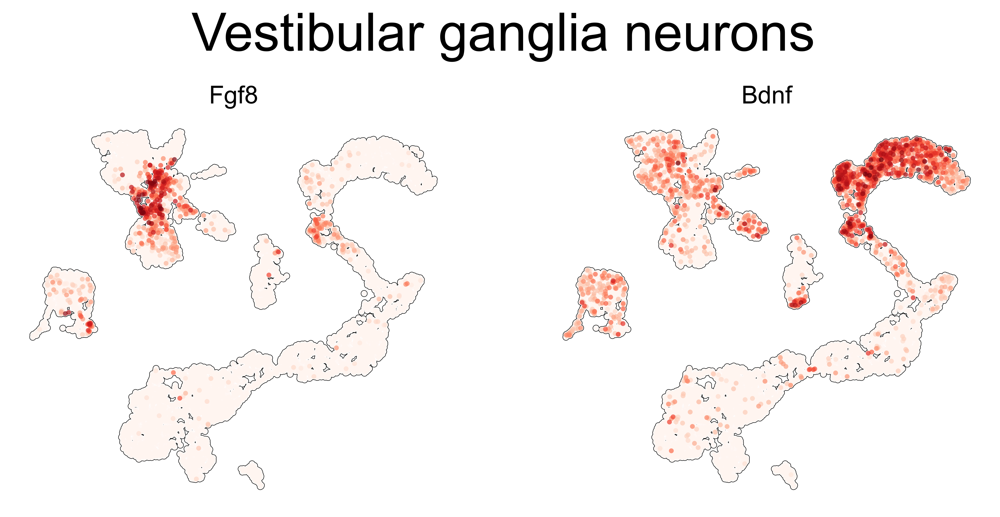

In [13]:
# Vestibular ganglia neurons
sc.pl.umap(subclustered,
           color=["Fgf8", "Bdnf"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )

# Add title above the plot while keeping gene name
plt.suptitle("Vestibular ganglia neurons", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make the gene name smaller
#plt.gca().set_title("Fgf8", fontsize=14)  # Adjust fontsize as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Fgf8", "Bdnf"]
for i, ax in enumerate(axes[:]):  # Only the first 3 axes (the UMAP plots)
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed

plt.savefig("figures/umap_subset_Vestibular_ganglia_neurons_high_res.svg")

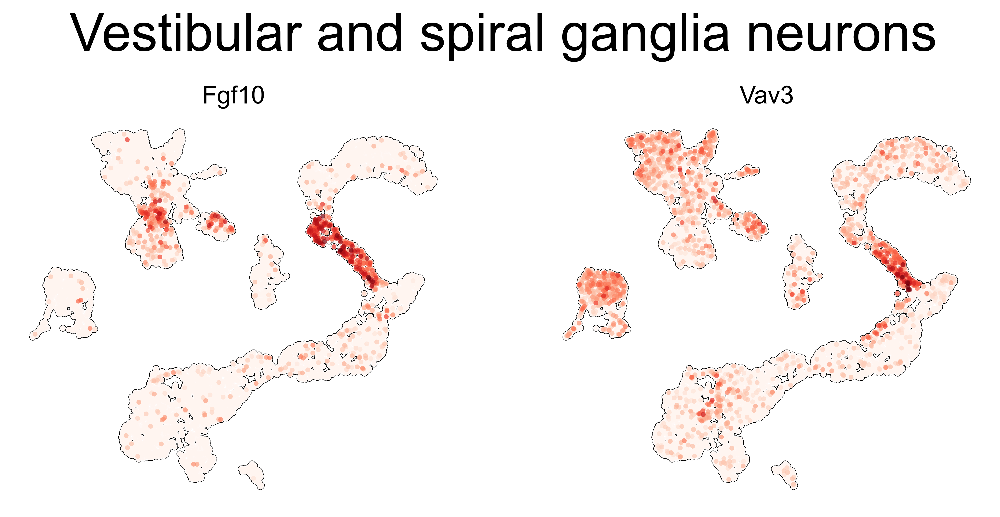

In [14]:
# Vestibular and spiral ganglia neurons
sc.pl.umap(subclustered,
           color=["Fgf10", "Vav3"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )

# Add title above the plot while keeping gene name
plt.suptitle("Vestibular and spiral ganglia neurons", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Fgf10", "Vav3"]
for i, ax in enumerate(axes[:3]):  # Only the first 3 axes (the UMAP plots)
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_Vestibular_and_spiral_ganglia_neurons_high_res.svg")

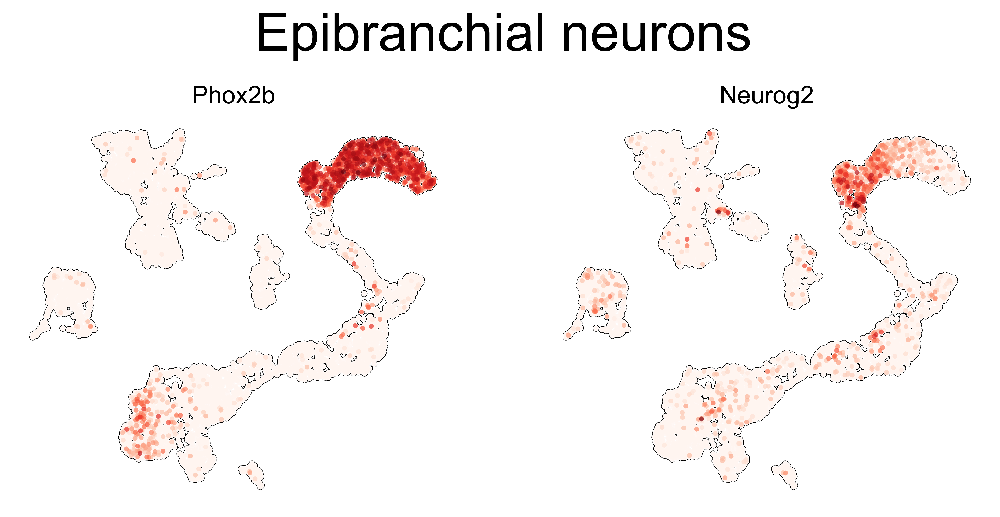

In [15]:
# Epibranchial neurons
sc.pl.umap(subclustered,
           color=["Phox2b", "Neurog2"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )

# Add title above the plot while keeping gene name
plt.suptitle("Epibranchial neurons", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Phox2b", "Neurog2"]

for i, ax in enumerate(axes[:5]):  # Only the first 3 axes (the UMAP plots)
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_Epibranchial_neurons_high_res.svg")

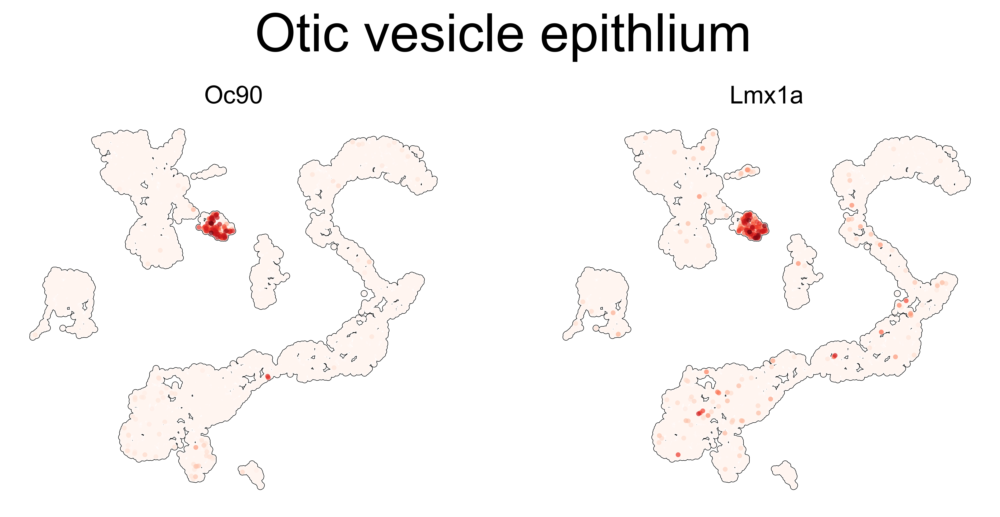

In [16]:
# Otic vesicle epithlium
sc.pl.umap(subclustered,
           color=["Oc90", "Lmx1a"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )

# Add title above the plot while keeping gene name
plt.suptitle("Otic vesicle epithlium", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Oc90", "Lmx1a"]

for i, ax in enumerate(axes[:3]):  # Only the first 3 axes (the UMAP plots)
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_Otic_vesicle_epithlium_high_res.svg")

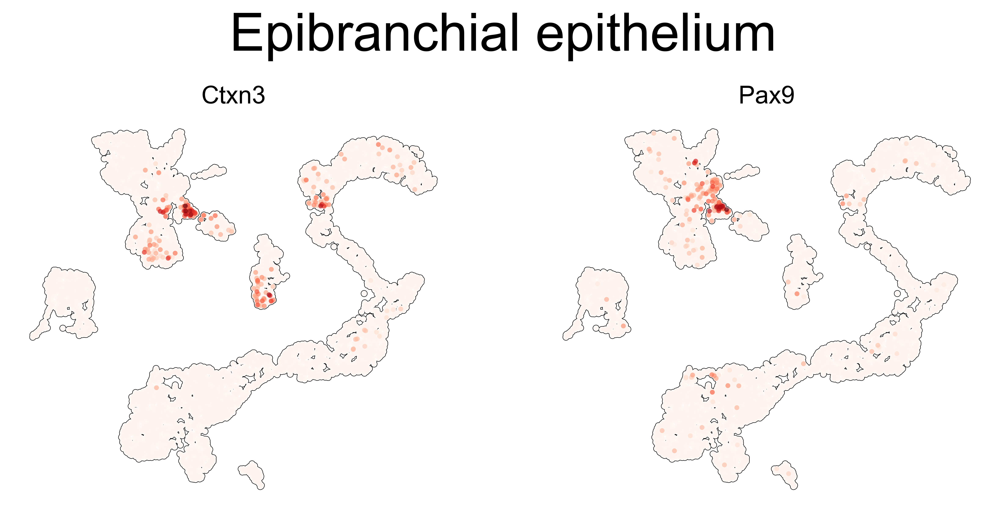

In [17]:
# Epibranchial epithelium
sc.pl.umap(subclustered,
           color=[ "Ctxn3", "Pax9"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )


# Add title above the plot while keeping gene name
plt.suptitle("Epibranchial epithelium", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = [ "Ctxn3", "Pax9"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_Epibranchial_epithelium_high_res.svg")

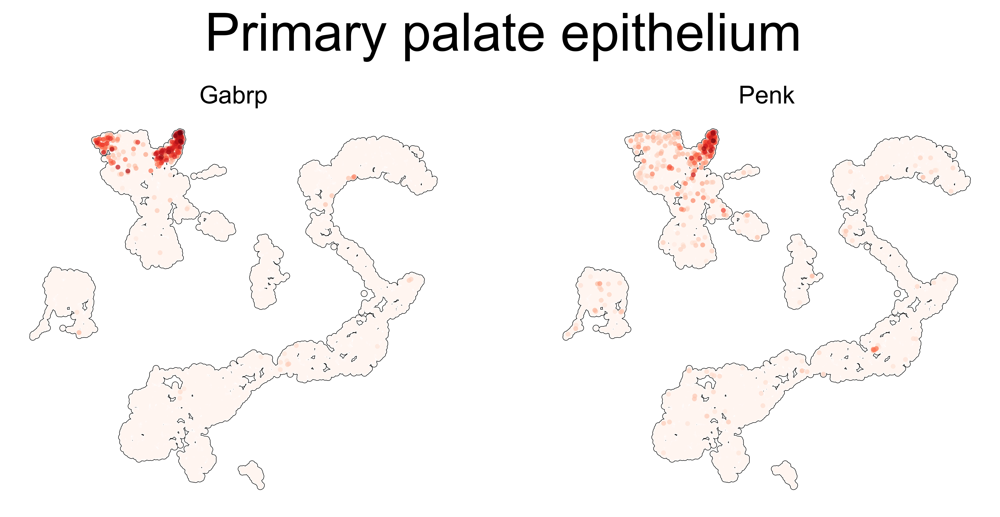

In [12]:
# Primary palate epithelium
sc.pl.umap(subclustered,
           color=["Gabrp", "Penk"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )


# Add title above the plot while keeping gene name
plt.suptitle("Primary palate epithelium", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Gabrp", "Penk"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_Primary_palate_epithelium_high_res.svg")

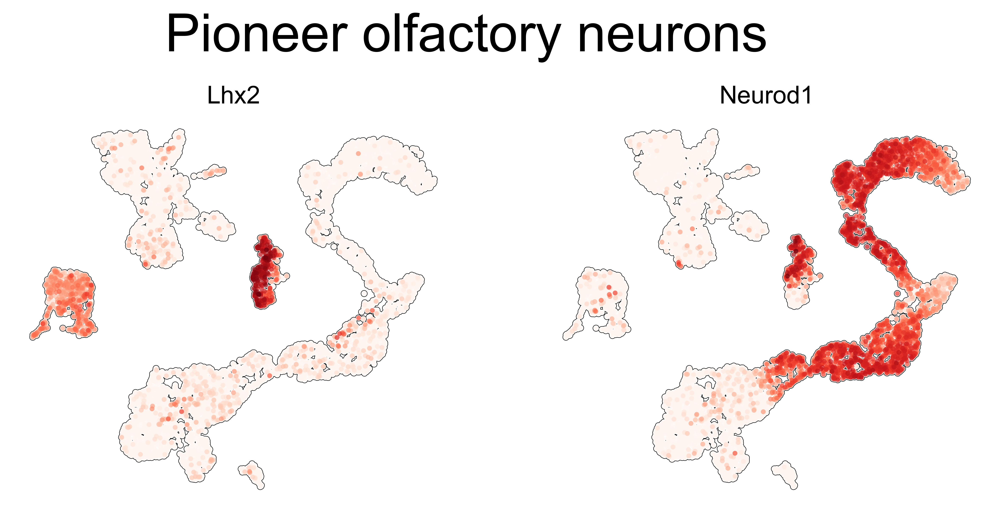

In [13]:
# Pioneer olfactory neruons
sc.pl.umap(subclustered,
           color=["Lhx2", "Neurod1"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )


# Add title above the plot while keeping gene name
plt.suptitle("Pioneer olfactory neurons", fontsize=30, y=1.1, x=0.47)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Lhx2", "Neurod1"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_Pioneer_olfactory_neurons_high_res.svg")

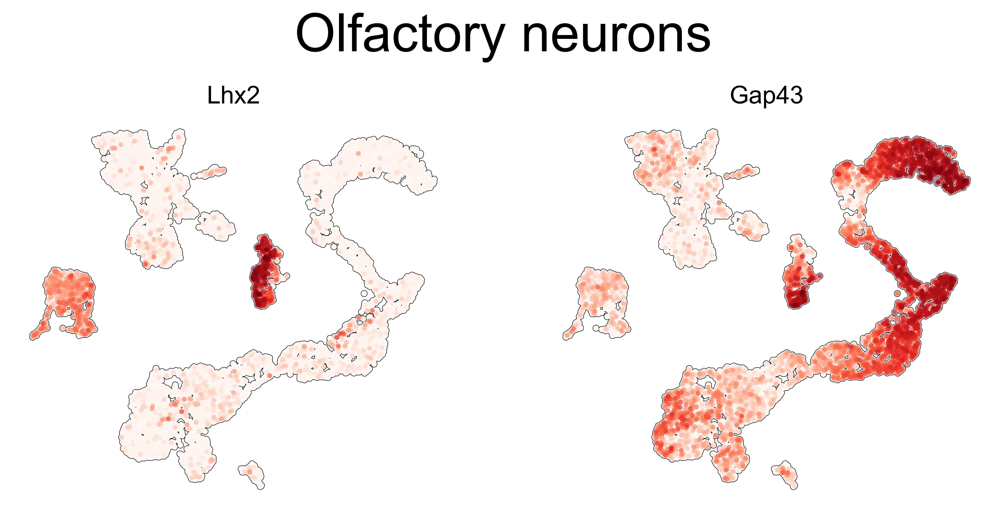

In [20]:
# Olfactory neurons
sc.pl.umap(subclustered,
           color=["Lhx2", "Gap43"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )

# Add title above the plot while keeping gene name
plt.suptitle("Olfactory neurons", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Lhx2", "Gap43"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_Olfactory_neurons_high_res.svg")

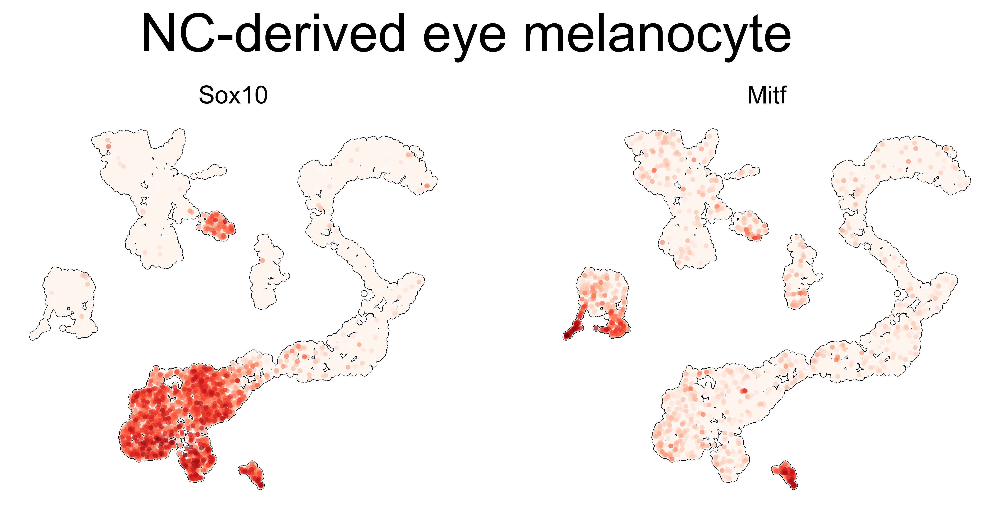

In [21]:
# NC-derived eye melanocyte
sc.pl.umap(subclustered,
           color=[ "Sox10", "Mitf"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )


# Add title above the plot while keeping gene name
plt.suptitle("NC-derived eye melanocyte", fontsize=30, y=1.1, x=0.47)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Sox10", "Mitf"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_NC-derived_eye_melanocyte_high_res.svg")

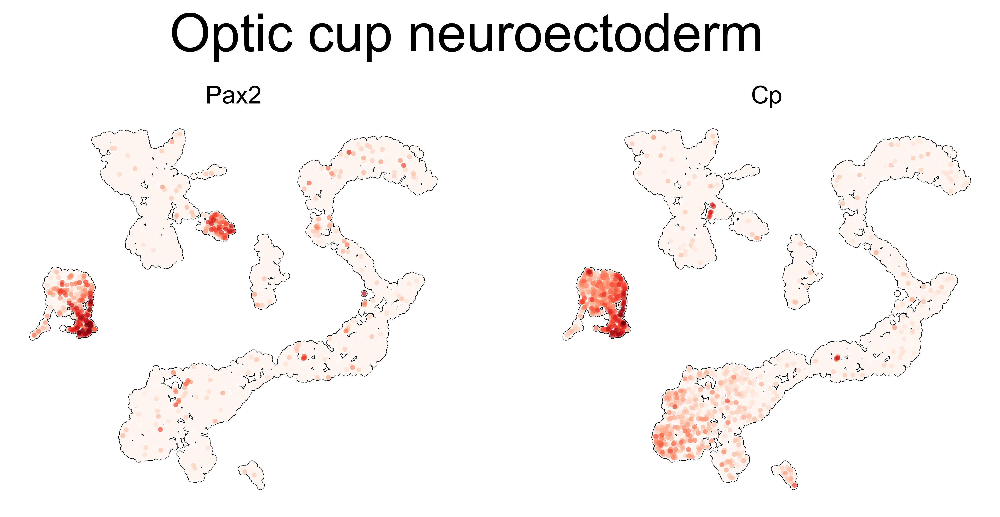

In [22]:
# Optic cup neuroectoderm
sc.pl.umap(subclustered,
           color=["Pax2", "Cp"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )


# Add title above the plot while keeping gene name
plt.suptitle("Optic cup neuroectoderm", fontsize=30, y=1.1, x=0.47)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Pax2", "Cp"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_Optic_cup_neuroectoderm_high_res.svg")

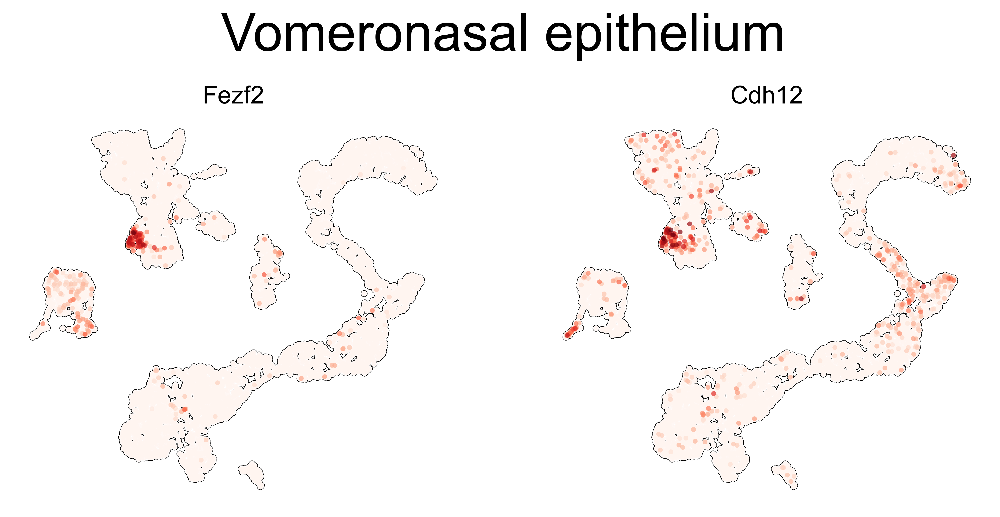

In [23]:
# Vomeronasal epithelium
sc.pl.umap(subclustered,
           color=["Fezf2", "Cdh12",],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )


# Add title above the plot while keeping gene name
plt.suptitle("Vomeronasal epithelium", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Fezf2", "Cdh12"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_Vomeronasal_epithelium_high_res.svg")

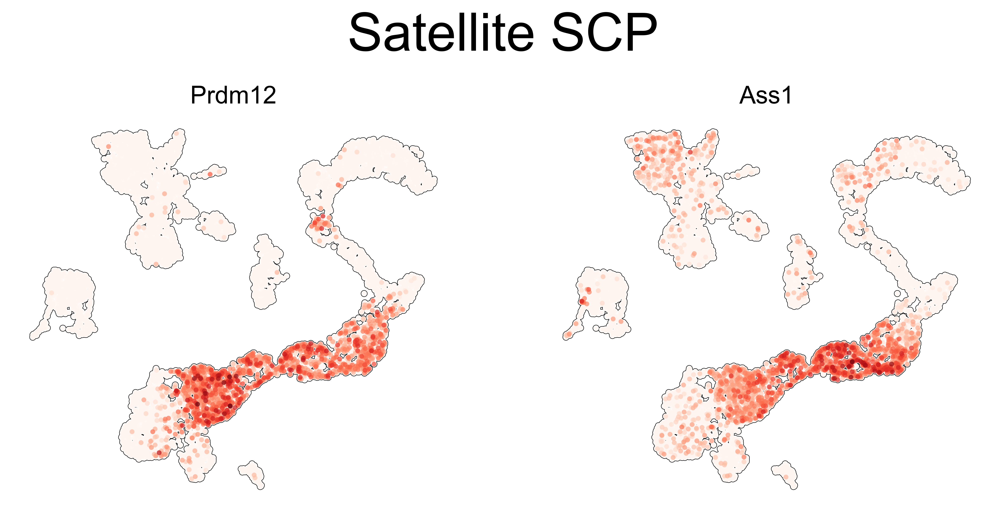

In [14]:
# Satellite SCP
sc.pl.umap(subclustered,
           color=["Prdm12", "Ass1"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )


# Add title above the plot while keeping gene name
plt.suptitle("Satellite SCP", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Prdm12", "Ass1"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_Satellite_SCP_high_res.svg")

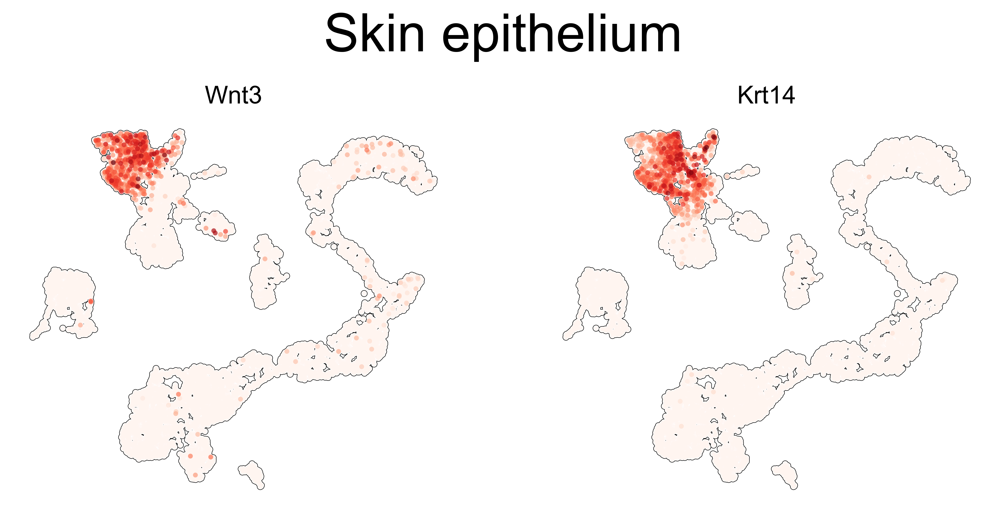

In [25]:
# Skin epithelium
sc.pl.umap(subclustered,
           color=["Wnt3", "Krt14"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )


# Add title above the plot while keeping gene name
plt.suptitle("Skin epithelium", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Wnt3",  "Krt14"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_Skin_epithelium_high_res.svg")

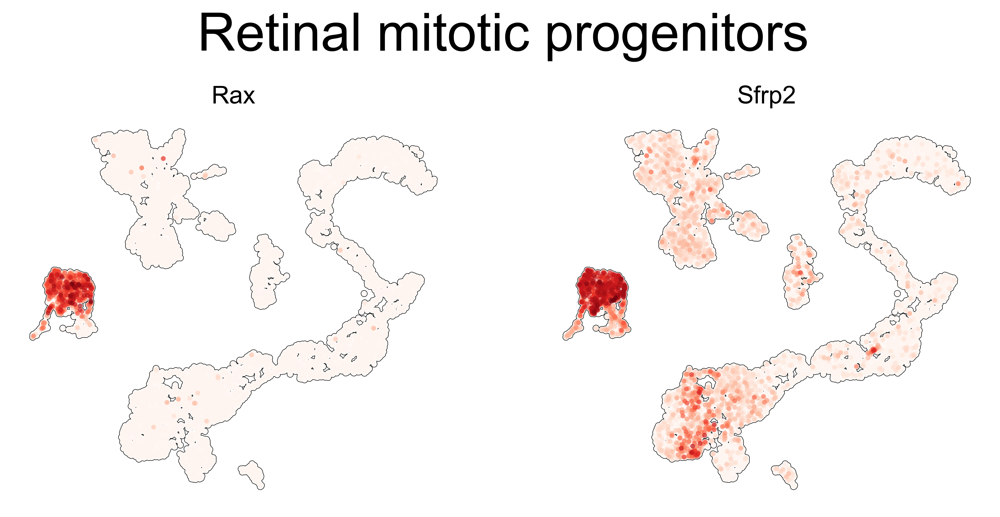

In [26]:
# Retinal mitotic progenitors
sc.pl.umap(subclustered,
           color=["Rax", "Sfrp2"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )


# Add title above the plot while keeping gene name
plt.suptitle("Retinal mitotic progenitors", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Rax", "Sfrp2"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_Retinal_mitotic_progenitors_high_res.svg")

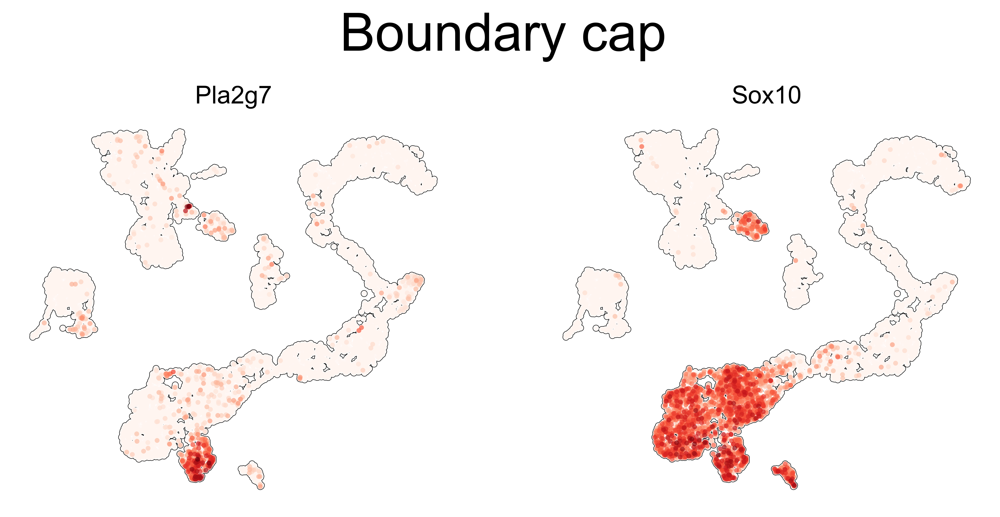

In [27]:
# Boundary cap
sc.pl.umap(subclustered,
           color=[ "Pla2g7", "Sox10"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )

# Add title above the plot while keeping gene name
plt.suptitle("Boundary cap", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = [ "Pla2g7", "Sox10"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_Boundary_cap_high_res.svg")

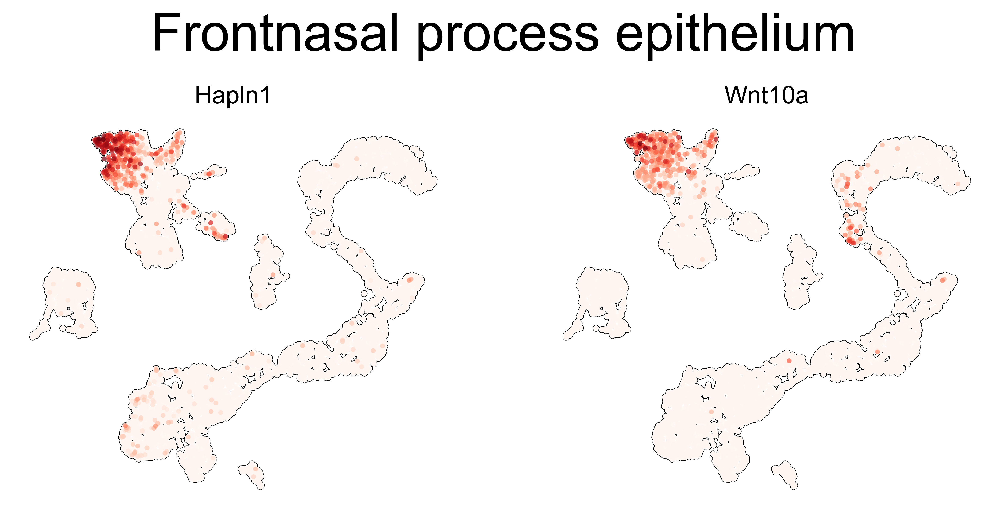

In [28]:
# Frontnasal process epithelium
sc.pl.umap(subclustered,
           color=["Hapln1", "Wnt10a"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )

# Add title above the plot while keeping gene name
plt.suptitle("Frontnasal process epithelium", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Hapln1", "Wnt10a"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_Frontnasal_process_epithelium_high_res.svg")

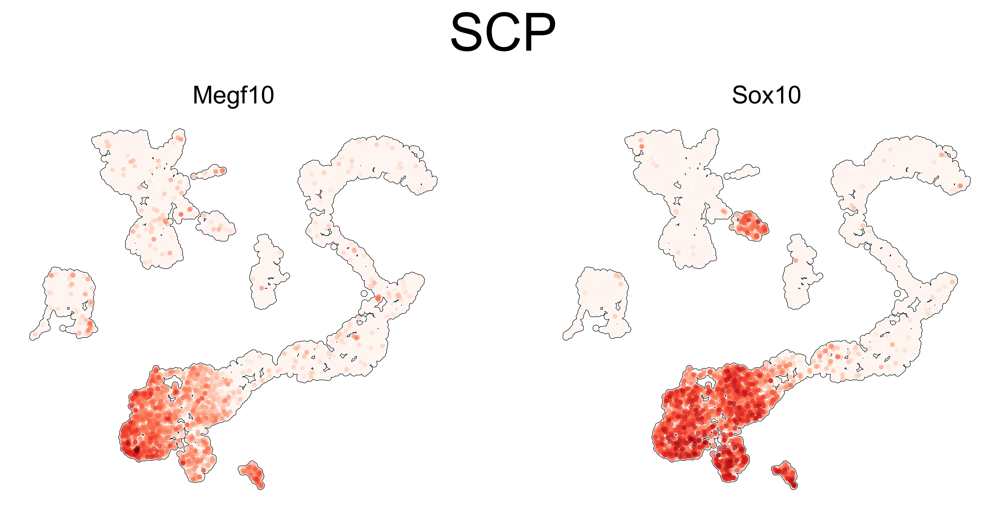

In [29]:
# SCP
sc.pl.umap(subclustered,
           color=["Megf10", "Sox10"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )

# Add title above the plot while keeping gene name
plt.suptitle("SCP", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Megf10", "Sox10"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_SCP_high_res.svg")

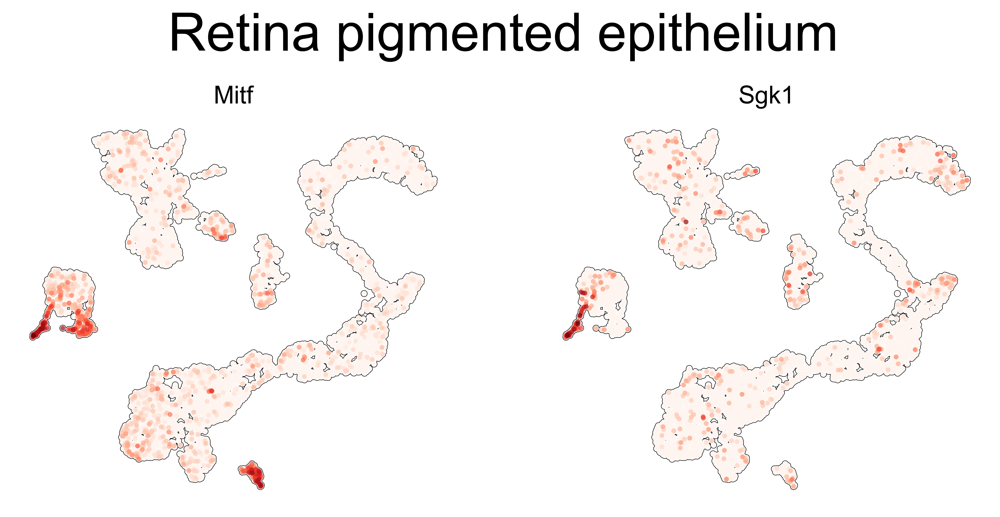

In [30]:
# Retina pigmented epithelium
sc.pl.umap(subclustered,
           color=["Mitf", "Sgk1",],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )

# Add title above the plot while keeping gene name
plt.suptitle("Retina pigmented epithelium", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Mitf", "Sgk1"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_retina_pigmented_epithelium_high_res.svg")

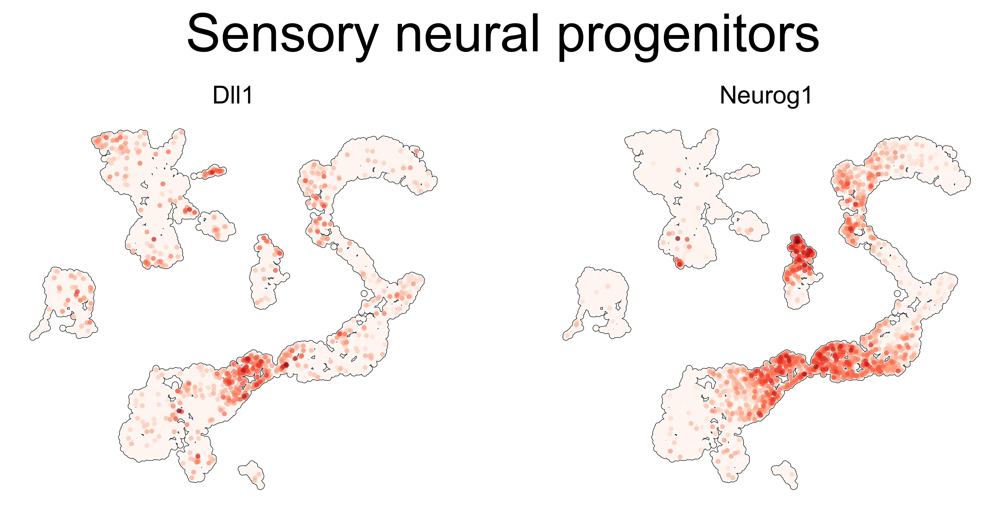

In [31]:
# Sensory neural progenitors
sc.pl.umap(subclustered,
           color=["Dll1", "Neurog1"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )

# Add title above the plot while keeping gene name
plt.suptitle("Sensory neural progenitors", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Dll1", "Neurog1"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_sensory_neural_progenitors_high_res.svg")

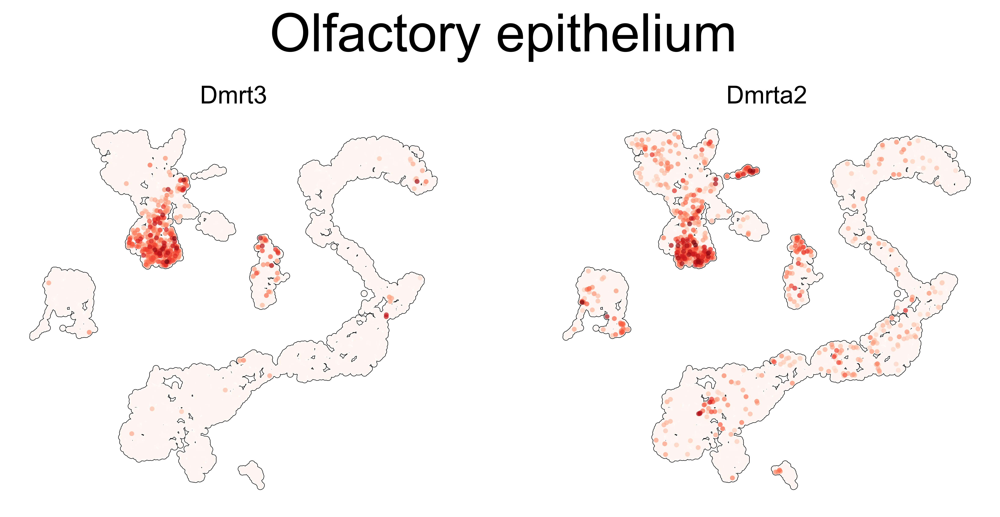

In [32]:
# Olfactory epithelium
sc.pl.umap(subclustered,
           color=["Dmrt3", "Dmrta2"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )

# Add title above the plot while keeping gene name
plt.suptitle("Olfactory epithelium", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Dmrt3", "Dmrta2"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_Olfactory_epithelium_high_res.svg")

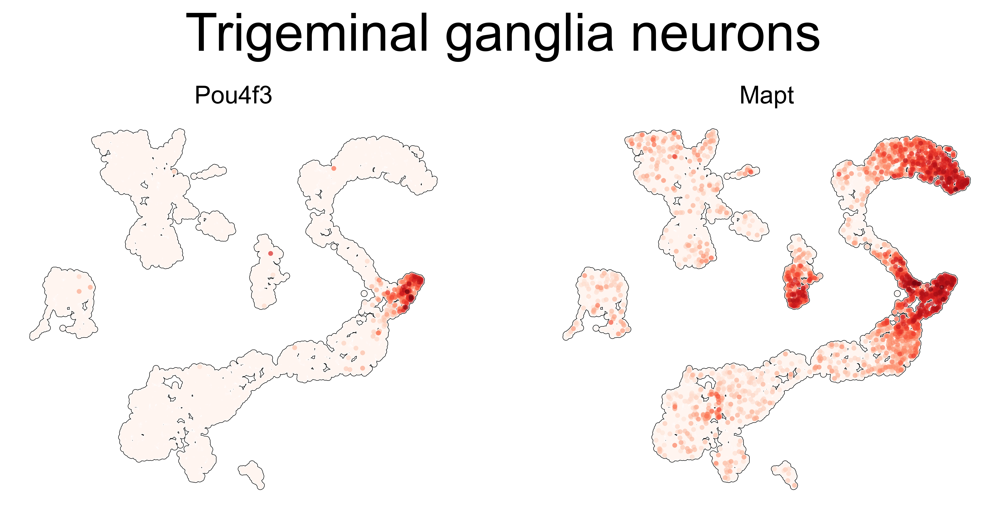

In [33]:
# Trigeminal ganglia neurons
sc.pl.umap(subclustered,
           color=["Pou4f3", "Mapt"],
           cmap="Reds",
           size=30,
           frameon=False,       
           colorbar_loc=None,
           add_outline=True,
           outline_width=(0.1, 0.1),
           legend_fontsize=20,
           show=False
          )

# Add title above the plot while keeping gene name
plt.suptitle("Trigeminal ganglia neurons", fontsize=30, y=1.1, x=0.5)  # Adjust fontsize and y position as needed

# Make gene names smaller for each subplot
fig = plt.gcf()
axes = fig.get_axes()
gene_names = ["Pou4f3", "Mapt"]

for i, ax in enumerate(axes[:]):  
    ax.set_title(gene_names[i], fontsize=14)  # Adjust fontsize as needed


plt.savefig("figures/umap_subset_trigeminal_ganglia_neurons_high_res.svg")